# Dependencies

In [ ]:
!pip install lime shap > /dev/null
!pip freeze | grep lime

lime==0.1.1.36


#### Generics

In [ ]:
import pandas as pd
import numpy as np
from random import uniform
import math
import matplotlib.pyplot as plt
from IPython.display import HTML, display
import matplotlib.pyplot as plt
import matplotlib.animation
import numpy as np

h3 = lambda s: display(HTML(f"<h3>{s}</h3>"))

# Dataset

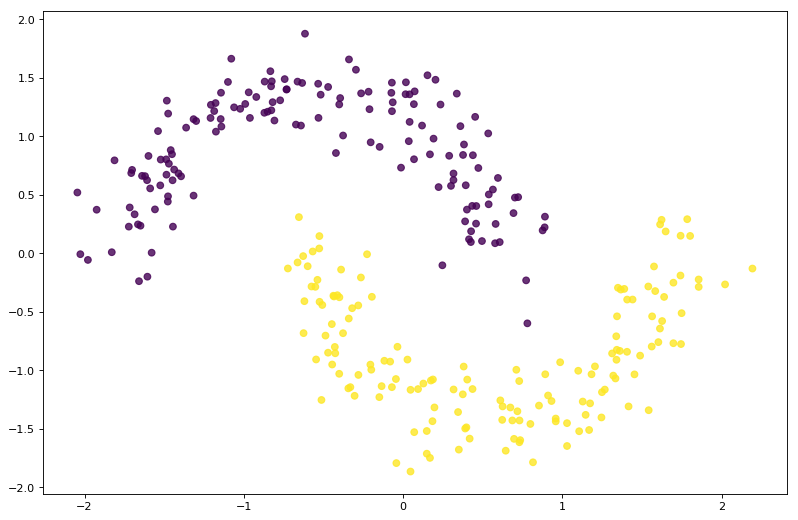

In [ ]:
from sklearn.datasets import make_moons
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import numpy as np

fig = plt.figure(figsize=(12, 8), dpi= 80)

moons = make_moons(n_samples=300, noise=.15, random_state=0)
data_set, classes = moons

data_set[:,1][classes == 0] += 0.4

from sklearn.preprocessing import StandardScaler
data_set = StandardScaler().fit_transform(data_set)

labels = [["b", "g"][l] for l in classes]
LABELS = tuple(labels)

train_set, test_set, train_labels, test_labels = train_test_split(
    data_set, labels, test_size=0.1)

plt.scatter(data_set[:, 0], data_set[:, 1], c=classes, alpha=0.8)
plt.show()

# Predicition models

In [ ]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score
import sklearn.ensemble

tree = DecisionTreeClassifier(max_depth=3)
tree.fit(train_set, train_labels)
predicted_labels = tree.predict(test_set)

score = accuracy_score(test_labels, predicted_labels)
h3(f"DecisionTreeClassifier Accuracy score = {score:.2f}")

forest = sklearn.ensemble.RandomForestClassifier(n_estimators=500)
forest.fit(train_set, train_labels)
predicted_labels = forest.predict(test_set)

score = accuracy_score(test_labels, predicted_labels)
h3(f"RandomForestClassifier Accuracy score = {score:.2f}")

knn = KNeighborsClassifier(n_neighbors=51)
knn.fit(train_set, train_labels)
predicted_labels = knn.predict(test_set)

score = accuracy_score(test_labels, predicted_labels)
h3(f"KNeighborsClassifier Accuracy score = {score:.2f}")

## Draw tree
https://medium.com/@rnbrown/creating-and-visualizing-decision-trees-with-python-f8e8fa394176


/usr/local/lib/python3.6/dist-packages/sklearn/externals/six.py:31: DeprecationWarning: The module is deprecated in version 0.21 and will be removed in version 0.23 since we've dropped support for Python 2.7. Please rely on the official version of six (https://pypi.org/project/six/).
  "(https://pypi.org/project/six/).", DeprecationWarning)


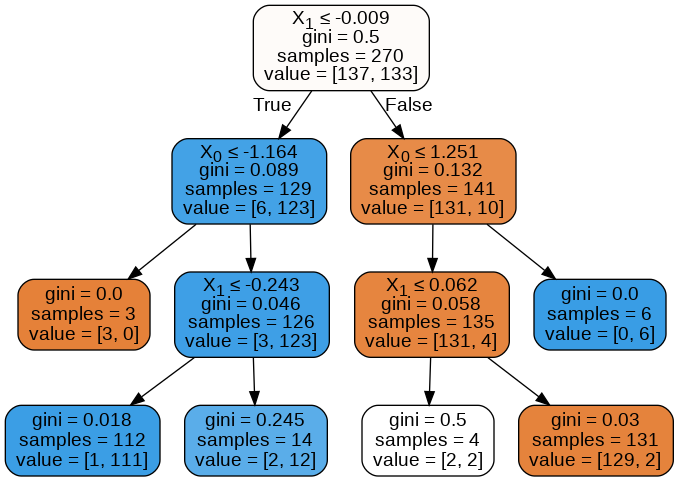

In [ ]:
from sklearn.externals.six import StringIO  
from sklearn.tree import export_graphviz
import pydotplus
from IPython.display import Image 

dot_data = StringIO()
export_graphviz(tree, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True)
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
Image(graph.create_png())

# Meshgrid of prediction probability

https://scikit-learn.org/stable/auto_examples/classification/plot_classifier_comparison.html

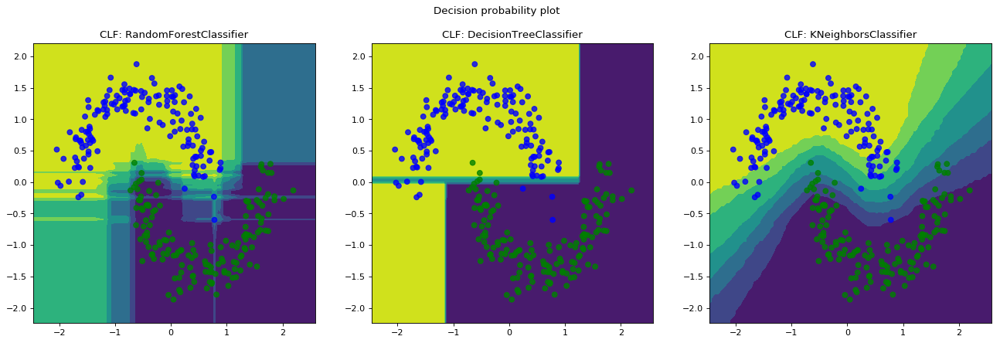

In [ ]:
def draw_decision_proba(classifier, data, labels, plot, padding=0.1):
    min_x = np.min(data[:, 0])
    max_x = np.max(data[:, 0])
    amplitude_x = max_x - min_x
    px = amplitude_x * padding

    min_y = np.min(data[:, 1])
    max_y = np.max(data[:, 1])
    amplitude_y = max_y - min_y
    py = amplitude_y * padding

    grid_step = 0.05

    x = np.arange(min_x - px, max_x + px, grid_step)
    y = np.arange(min_y - py, max_y + py, grid_step)

    xx, yy = np.meshgrid(x, y)
    
    # z = forest.predict(np.c_[xx.ravel(), yy.ravel()])

    # https://gist.github.com/tkf/2276773
    z = classifier.predict_proba(np.c_[xx.ravel(), yy.ravel()])[:,0]
    z = np.array(z)
    z = z.reshape(xx.shape)#.view(np.uint32)

    h = plot.contourf(x, y, z)
    plot.scatter(data[:, 0], data[:, 1], c=labels, alpha=0.8)
    plot.set_title(f'CLF: {classifier.__class__.__name__}')

# create two plots
fig = plt.figure(figsize=(20, 6), dpi= 80)
left_plt, middle_plt, right_plt = fig.subplots(1, 3)
fig.suptitle('Decision probability plot')

draw_decision_proba(forest, data_set, labels, left_plt)
draw_decision_proba(tree, data_set, labels, middle_plt)
draw_decision_proba(knn, data_set, labels, right_plt)

# Explainer

In [ ]:
import lime
import lime.lime_tabular
import matplotlib.pyplot as plt


def as_pyplot_subplot(explanation, plot, plot_info, plot_points, verbose=False, **kwargs):
    labels = explanation.class_names
    proba = list(explanation.predict_proba.astype(float))

    label = list(sorted(explanation.as_map().keys()))[0]
    exp = explanation.as_list(label=label)
    
    exp = sorted(exp, key=lambda x: x[0])
    if exp[0][1] < 0:
        exp = [(a,-b) for a,b in exp]
    
    if verbose:
        print("\niter")
        print(explanation.as_map())
        print(exp)
        print("intercept ", explanation.intercept)
        print("local_exp ", explanation.local_exp)
        print("score     ", explanation.score)
        print("local_pred", explanation.local_pred)

        print(explanation.domain_mapper)
        print(explanation.domain_mapper.map_exp_ids(explanation.local_exp[label]))

        print("exp_feature_names", explanation.domain_mapper.exp_feature_names)
        print("discretized_feature_names", explanation.domain_mapper.discretized_feature_names)
        print("feature_names", explanation.domain_mapper.feature_names)
        print("feature_values", explanation.domain_mapper.feature_values)
        print("feature_indexes", explanation.domain_mapper.feature_indexes)
        print("scaled_row", explanation.domain_mapper.scaled_row)
        print("all_categorical", explanation.domain_mapper.all_categorical)
        print("categorical_features", explanation.domain_mapper.categorical_features)
        print("scaler_vars", explainer.scaler.var_)

    vals = [x[1] for x in exp]
    names = [x[0] for x in exp]
    vals.reverse()
    names.reverse()
    colors = ['green' if x > 0 else 'red' for x in vals]
    
    pos = np.arange(len(exp))

    # weights horizontal bar graph
    plot.barh(pos, vals, align='center', color=colors, height=0.3)
    plot.set_yticks(pos, minor=False)
    plot.set_yticklabels(names, fontdict=None, minor=False, rotation=45)
    plot.set_xlabel("Weight")
    plot.set_xticks(np.arange(-1., 1., 0.1), minor=False)
    
    exp_dict = dict(explanation.as_list(label=label))
    kx, ky = exp_dict['X'], exp_dict['Y']
    x, y = explanation.domain_mapper.scaled_row
    b = explanation.intercept[label]
    plot_points.quiver(x, y, kx * 2, ky * 2, units='xy' ,scale=1, label='')
    
    # 2d plane of the lime local linear aproximator
    f = lambda x, y: x * kx + y * ky + b
    # 1d line of the 50% decision line
    g = lambda x: (0.5 - (x * kx + b)) / ky
    
    xr = 2.9
    plot_points.plot([-xr, xr], [g(-xr), g(xr)], 'w')

    # info
    index = np.arange(len(labels))
    colors = ['green'] + ['red'] * len(proba)
    plot_info.barh(index, proba, align='center', color=colors, height=0.3)
    plot_info.set_ylabel('Class name')
    plot_info.set_xlabel('Probability')
    plot_info.set_xticks(np.arange(0., 1., 0.1), minor=False)
    plot_info.set_yticks(index, minor=False)
    plot_info.set_yticklabels(labels, fontdict=None, minor=False, rotation=30)

    # title
    if explanation.mode == "classification":
        title = 'Local explanation for class %s' % explanation.class_names[label]
    else:
        title = 'Local explanation'
    plot.set_title(title)



def explain_with_plot(explainer, classifier, point, plot, plot_info, plot_points):
    plot_info.set_title(f"Class res {classifier.predict([point])[0]}: {point[0]:.2f} {point[1]:.2f}")

    exp = explainer.explain_instance(point, classifier.predict_proba, num_features=2, top_labels=1)
    as_pyplot_subplot(exp, plot, plot_info, plot_points, verbose=False) 

    
explainer = lime.lime_tabular.LimeTabularExplainer(
    data_set, 
    feature_names=["X", "Y"],
    class_names=["b", "g"],
    discretize_continuous=False,
    mode='classification',
    discretizer='decile',
)
        
# create two plots
fig = plt.figure(figsize=(20, 6), dpi= 80)
plt.close()
left_plt, middle_plt, right_plt = fig.subplots(1, 3)
fig.suptitle('Decision explanation')

points = ([np.array((2.9, py)) for py in np.arange(-1.25, 1.25, 0.0625)] +
            [np.array((-px, 1.25)) for px in np.arange(-2.9, 2.9, 0.08)] +
            [np.array((-2.9, -py)) for py in np.arange(-1.25, 1.25, 0.0625)] +
            [np.array((px, -1.25)) for px in np.arange(-2.9, 2.9, 0.08)])


def animate(i):
    right_plt.clear()
    middle_plt.clear()
    left_plt.clear()
    
    point = points[i]
    draw_decision_proba(knn, data_set, labels, right_plt, padding=.45)
    
    explain_with_plot(explainer, knn, point, left_plt, middle_plt, right_plt)
    
    right_plt.scatter(point[0], point[1], color="r", s=80)

    
# http://louistiao.me/posts/notebooks/embedding-matplotlib-animations-in-jupyter-notebooks/        
ani = matplotlib.animation.FuncAnimation(fig, animate, frames=len(points), interval=100)

Links:  
https://towardsdatascience.com/simple-and-multiple-linear-regression-with-python-c9ab422ec29c  
https://math.oregonstate.edu/home/programs/undergrad/CalculusQuestStudyGuides/vcalc/grad/grad.html  
https://github.com/marcotcr/lime/blob/96fb753193711ea6a92b65d0ac8f2d5f10cd327a/lime/lime_tabular.py#L447  
https://github.com/marcotcr/lime/blob/ba7d7a01b3e64bdf8e8613f6a35d6916bb9bb8b3/lime/lime_base.py#L193  

### Animation
- change speed with - / +
- click on reflect option

## Explanation

#### Prelude

LimeTabularExplainer uses by default discretization which converts a continious feature, like X, to a bunch on binary features, like a column for 0 < X < 10, and a column for 10 < X < 20, and so on.
The ranges are calculated based on some unimportant statistics calculated on the training data passed to the LimeTabularExplainer constructor.


### Interpreting decision boundary

LimeTabularExplainer.explain_instance has an argument `model_regressor` which is a `sklearn` regressor.
  
- Defaults to Ridge regression in LimeBase. 
- Must have model_regressor.coef_ and ‘sample_weight’ as a parameter to model_regressor.fit()

This means we can use the familiar LinearRegression as a substitute.

In both cases the mathematical model for the result approximator would for 1 dimensional data:
 - f = k * x + b, where f is the probability, x the feature, and k the slope

`z_proba = feat_1 * k1 + feat_2 * k2 + b`  
or  
`z = x1 * k1 + x2 * k2 + b`  

where kn are the slopes for each feature.

So...  
The slope k of each feature is the **weight** that LIME gives you.  
The intercept b is discarded.

So the weights are slopes in the direction of higher probability (the z value) of the equation.

What lime does, it finds by sampling random points the local tangent line / plane.

### The result:

- using the slope values, you can plot a line to the direction of highest probability
  - the arrow on dot 
- solving the plane equaiton for the 50% probability line
  - 0.5 = k1 * feature_1 + k2 * feature_2 * k2 + b
  - feature_2 = ( 0.5 - k1 * feature_1 - b ) / k2
  - y = (0.5 - k1 * x - b ) / k2
 
 

In [ ]:
display(HTML(ani.to_jshtml()))

In [ ]:
display(HTML(ani.to_html5_video()))

In [ ]:
import json

with open("/var/log/colab-jupyter.log", "r") as fo:
    for line in fo:
        print(json.loads(line)['msg'])

/usr/local/lib/python2.7/dist-packages/IPython/utils/traitlets.py:5: UserWarning: IPython.utils.traitlets has moved to a top-level traitlets package.
  warn("IPython.utils.traitlets has moved to a top-level traitlets package.")
Writing notebook server cookie secret to /root/.local/share/jupyter/runtime/notebook_cookie_secret
google.colab serverextension initialized.
Serving notebooks from local directory: /
0 active kernels
The Jupyter Notebook is running at:
http://172.28.0.2:9000/
Use Control-C to stop this server and shut down all kernels (twice to skip confirmation).
Kernel started: ca037131-5616-4dc0-af7d-c3ef4b03fb20
Adapting to protocol v5.1 for kernel ca037131-5616-4dc0-af7d-c3ef4b03fb20
Adapting to protocol v5.1 for kernel ca037131-5616-4dc0-af7d-c3ef4b03fb20
Adapting to protocol v5.1 for kernel ca037131-5616-4dc0-af7d-c3ef4b03fb20
